In [1]:
import math
import numpy as np

import cv2
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm
import plotly.graph_objects as go
%matplotlib inline

import tensorflow as tf
tf.keras.backend.clear_session()
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))
tf.debugging.set_log_device_placement(True)

import logging
logger = tf.get_logger()
logger.setLevel(logging.ERROR)

import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'  # FATAL
logging.getLogger('tensorflow').setLevel(logging.FATAL)

Num GPUs Available:  1


In [2]:
print(tf.__version__)

2.1.0


In [3]:
def load_horses_orig(path, image_size):
    mask_path = path + 'masks/'
    image_path = path + 'images/'
    images = []
    masks = []
    test_images = []
    test_masks = []
    
    for i in range(328):
        
        orig_im = cv2.imread(image_path + 'image-{}.png'.format(i))
        orig_im= cv2.cvtColor(orig_im, cv2.COLOR_RGB2BGR)
        
        low_im = cv2.resize(orig_im, dsize=(image_size, image_size))

        orig_mask = cv2.imread(mask_path + 'mask-{}.png'.format(i))
        low_mask = cv2.resize(orig_mask, dsize=(image_size, image_size))
        low_mask = cv2.cvtColor(low_mask, cv2.COLOR_RGB2GRAY)
        bin_mask = (low_mask > 0) + 0
        
        images.append(low_im)
        masks.append(bin_mask)
    
    xtest = np.reshape(np.array(images[250:]), (-1,image_size, image_size, 3))
    ytest = np.reshape(np.array(masks[250:]), (-1, image_size, image_size, 1))
    xdata = np.reshape(np.array(images[:200]), (-1,image_size, image_size, 3))
    ydata = np.reshape(np.array(masks[:200]), (-1, image_size, image_size, 1))
    yval =  np.reshape(np.array(masks[200:250]), (-1, image_size, image_size, 1))
    xval = np.reshape(np.array(images[200:250]), (-1,image_size, image_size, 3))
    return xdata, xval, xtest, ydata, yval, ytest

In [4]:
#change the path address 
path = './horses/'
image_size = 32
xdata, xval, xtest, ydata, yval, ytest = load_horses_orig(path, image_size)

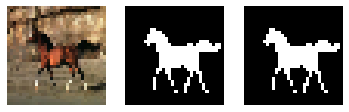

(32, 32, 3) (32, 32, 1)


In [5]:
def draw(image, mask):
    fig, (ax1,ax2) = plt.subplots(1,2) 
    ax1.axis('off')
    ax2.axis('off')
    ax1.imshow(np.reshape(image, (image_size,image_size,3)))
    ax2.imshow(np.reshape(mask, (image_size,image_size)), cmap=plt.cm.gray)
    plt.show()

def draw_all(image, real_mask, fake_mask):
    fig, (ax1,ax2,ax3) = plt.subplots(1,3)
    ax1.axis('off')
    ax2.axis('off')
    ax3.axis('off')
    ax1.imshow(image)
    ax2.imshow(real_mask, cmap=plt.cm.gray)
    ax3.imshow(fake_mask, cmap=plt.cm.gray)
    plt.show()
    
draw_all(xdata[0], ydata[0], ydata[0])
print(xdata[0].shape, ydata[0].shape)

In [6]:
# Do not change this cell
def iou(ytrue, yprediction):
    yp = yprediction
    yt = ytrue
    yp = yp > 0.5 + 0
    intersect = np.sum(np.minimum(yp, yt))
    union = np.sum(np.maximum(yp, yt))
    return np.average(intersect / (union+0.0))

In [7]:
assert iou(ydata, ydata) == 1.0

# CNN GAN

In [8]:
class Discriminator(tf.keras.Model):
    def __init__(self):
        super(Discriminator, self).__init__()
        
        self.concat_layer = tf.keras.layers.Concatenate(axis=3)
        
        self.conv1 = tf.keras.layers.Conv2D(1, 3, 2, activation = tf.nn.softplus)
        self.conv2 = tf.keras.layers.Conv2D(32, 3, 2, activation = tf.nn.softplus)
        self.conv3 = tf.keras.layers.Conv2D(64, 3, 2, activation = tf.nn.softplus)
        self.conv4 = tf.keras.layers.Conv2D(128, 3, 2, activation = tf.nn.softplus)
        
        self.flatten = tf.keras.layers.Flatten()
        self.fc_score = tf.keras.layers.Dense(1)

    def call(self, x, yt, y):
        x = tf.cast(x, tf.float32)
        yt = tf.cast(yt, tf.float32)
        y = tf.cast(y, tf.float32)

        x = self.concat_layer([x, yt, y])
        x = self.conv1(x)
        x = self.conv2(x)
        x = self.conv3(x)
        x = self.conv4(x)
        x = self.flatten(x)
        x = self.fc_score(x)
        return x

class Generator(tf.keras.Model):
    def __init__(self):
        super(Generator, self).__init__()

        self.concat_layer = tf.keras.layers.Concatenate(axis=3)
        self.conv1 = tf.keras.layers.Conv2DTranspose(128, 3, 2, activation = tf.nn.softplus, padding = 'same')
        self.conv2 = tf.keras.layers.Conv2DTranspose(64, 3, 2, activation = tf.nn.softplus, padding = 'same')
        self.conv3 = tf.keras.layers.Conv2DTranspose(32, 3, 2, activation = tf.nn.softplus, padding = 'same')
        self.conv4 = tf.keras.layers.Conv2DTranspose(1, 3, 2, activation = tf.nn.softplus, padding = 'same')
        
        self.flatten = tf.keras.layers.Flatten()
        self.fc_energy = tf.keras.layers.Dense(1)
        
    def call(self, x, z):
        x = tf.cast(x, tf.float32)
        x = self.concat_layer([x, z])
        
        x = self.conv1(x)
        x = self.conv2(x)
        x = self.conv3(x)
        x = self.conv4(x)
        x = self.flatten(x)
        x = self.fc_energy(x)
        return x

# Unrolled Inference

In [9]:
def compute_gradient(x, y):
    y = tf.Variable(y)
    with tf.GradientTape() as t:
        t.watch(y)
        energy = gen(x, y)
    return t.gradient(energy, y)

def unrolled_inf(images, fake_label, inf_iter, inf_rate):
    yp_ind = fake_label;    y_start = yp_ind;     current_yp_ind = y_start
    
    yp_ar = []
    for i in range(inf_iter):
        gradients = compute_gradient(images, yp_ind)
        
        next_yp_ind = tf.math.add(current_yp_ind, tf.math.multiply(inf_rate, gradients))
        
        # Langevin dynamics
        temp = tf.cast(inf_rate/2, tf.float32)
        temp = temp * gradients + tf.random.normal(gradients.get_shape().as_list(), mean=0, stddev=inf_rate)
        next_yp_ind = next_yp_ind + temp
        current_yp_ind = next_yp_ind
        
        yp_ind = current_yp_ind
        yp_ar.append(yp_ind)
        
    yp = yp_ar[-1]
    yp = tf.nn.sigmoid(yp)
    return yp

def test_time_inf(images, fake_label, inf_iter, inf_rate):
    yp_ind = fake_label;    y_start = yp_ind;     current_yp_ind = y_start
    
    yp_ar = []
    for i in range(inf_iter):
        gradients = compute_gradient(images, yp_ind)
        
        next_yp_ind = tf.math.add(current_yp_ind, tf.math.multiply(inf_rate, gradients))
        
        # Langevin dynamics
        temp = tf.cast(inf_rate/2, tf.float32)
        temp = temp * gradients
        next_yp_ind = next_yp_ind + temp
        current_yp_ind = next_yp_ind
        
        yp_ind = current_yp_ind
        yp_ar.append(yp_ind)
        
    yp = yp_ar[-1]
    yp = tf.nn.sigmoid(yp)
    return yp

# Visualization

In [10]:
def plot_figure(loss, arange, brange, start, end, step, plot_name):
    axis_length = len(np.linspace(start, end, step))
    loss = loss.numpy().reshape(-1, axis_length)

    # plot the surface plot with plotly's Surface
    fig = go.Figure(data=go.Surface(z=loss,
                                    x=arange,
                                    y=brange))

    # add a countour plot
    fig.update_traces(contours_z=dict(show=True, usecolormap=True,
                                      highlightcolor="limegreen", project_z=True))

    # annotate the plot
    fig.update_layout(title=plot_name,
                      scene=dict(
                        xaxis_title='Pred. Label Axis-0',
                        yaxis_title='Pred. Label Axis-1',
                        zaxis_title=plot_name),
                      width=700, height=700)

    fig.show()
    
def generate_vectors(real_image, real_label, fake_label, start, end, step):
    arange = np.linspace(start, end, step)
    brange = np.linspace(start, end, step)

    alen = arange.shape[0]
    blen = brange.shape[0]

    r1 = np.random.uniform(0, 1, (fake_label.shape[0], image_size * image_size))
    r1[:,0] = 1 - r1[:,1]
    r2 = np.random.uniform(0, 1, (fake_label.shape[0], image_size * image_size))
    r2[:,0] = 1 - r2[:,1]
    
    y_img = np.zeros((alen*blen, fake_label.shape[0], image_size * image_size * 3))
    y_pred = np.zeros((alen*blen, fake_label.shape[0], image_size * image_size))
    y_true = np.zeros((alen*blen, fake_label.shape[0], image_size * image_size))
    for b in range(0,blen):
        for a in range(0,alen):
            k = arange[a]
            l = brange[b]
            y_pred[b*alen+a] = tf.clip_by_value(fake_label[0, :] + l*r1[0, :] + k*r2[0, :], 0.0, 1.0) # just one horse
            y_true[b*alen+a] = real_label[0]
            y_img[b*alen+a] = real_image[0]
    return arange, brange, y_img, y_pred, y_true

def plot_contour_ce(real_image, real_label, inf_iter, inf_rate, start, end, step):
    batch_size = real_label.shape[0]
    z = tf.random.uniform([batch_size, image_size, image_size, 1], 0.0, 1.0)
    fake_label = test_time_inf(real_image, z, inf_iter, inf_rate)
    
    fake_label = np.array(fake_label).reshape(-1, image_size * image_size)
    real_label = np.array(real_label).reshape(-1, image_size * image_size)
    real_image = np.array(real_image).reshape(-1, image_size * image_size * 3)

    arange, brange, y_img, y_pred, y_true = generate_vectors(real_image, real_label, fake_label, start, end, step)

    # CE Loss
    loss = tf.keras.losses.binary_crossentropy(y_true, y_pred)
    plot_figure(loss, arange, brange, start, end, step, 'Cross Entropy')
    
    
def plot_contour_adv(real_image, real_label, inf_iter, inf_rate, start, end, step):
    batch_size = real_label.shape[0]
    z = tf.random.uniform([batch_size, image_size, image_size, 1], 0.0, 1.0)
    fake_label = test_time_inf(real_image, z, inf_iter, inf_rate)
    
    fake_label = np.array(fake_label).reshape(-1, image_size * image_size)
    real_label = np.array(real_label).reshape(-1, image_size * image_size)
    real_image = np.array(real_image).reshape(-1, image_size * image_size * 3)
    
    # Adv loss
    arange, brange, y_img, y_pred, y_true = generate_vectors(real_image, real_label, fake_label, start, end, step)
    
    real_image = y_img.reshape(-1, image_size, image_size, 3)
    real_label = y_true.reshape(-1, image_size, image_size, 1)
    fake_label = y_pred.reshape(-1, image_size, image_size, 1)
    
    # disc signals
    real_score = dis(real_image, real_label, real_label)
    fake_score = dis(real_image, real_label, fake_label)

    fake_loss = tf.math.log(tf.math.maximum(1.0 - fake_score, 1e-9))
    real_loss = tf.math.log(tf.math.maximum(real_score, 1e-9))

    # adv loss = log ( 1 - D(x, y*, y)) + log( D(x, y*,y*))
    loss = fake_loss + real_loss
    
    plot_figure(loss, arange, brange, start, end, step, 'Adversarial loss')
    
    
def plot_hist(fake, real):
    fake = np.array(fake).reshape(-1, 1)
    real = np.array(real).reshape(-1, 1)
    bins = len(fake)
    plt.figure(figsize=(15,5))
    plt.hist(fake, bins, alpha=0.5, color='blue', label='Fake')
    plt.hist(real, bins, alpha=0.5, color='orange', label='Real')
    plt.legend(loc='upper right')
    plt.show()
    
def calc_iou(images, labels, inf_iter, inf_rate):
    batch_size = labels.shape[0]
    z = tf.random.uniform([batch_size, image_size, image_size, 1], 0.0, 1.0)
    fake_label = test_time_inf(images, z, inf_iter, inf_rate)
    return iou(labels, fake_label)

def draw_test(images, labels, inf_iter, inf_rate, name):
    batch_size = labels.shape[0]
    z = tf.random.uniform([batch_size, image_size, image_size, 1], 0.0, 1.0)
    fake_label = test_time_inf(images, z, inf_iter, inf_rate)
    iou_score = iou(labels, fake_label)
    print('\n' + name + ' iou_score %:', round(iou_score*100, 2))
    
    for i in range(10):
        draw_all(images[i], labels[i], fake_label[i])
        
def plot_iou(epoch, train_iou, val_iou, test_iou):
    plt.plot(np.arange(epoch+1), np.array(train_iou), label = "train")
    plt.plot(np.arange(epoch+1), np.array(val_iou), label = "test")
    plt.plot(np.arange(epoch+1), np.array(test_iou), label = "valid")
    plt.xlabel('Epoch')
    plt.ylabel('IOU Score')
    plt.legend()
    plt.show()

# Training Functions

In [11]:
def train_step_gen(real_image, real_label, inf_iter, inf_rate, pt_loss, alpha):
    batch_size = real_image.get_shape().as_list()[0]
    z = tf.random.uniform([batch_size, image_size, image_size, 1], 0.0, 1.0)
    real_label = tf.cast(real_label, dtype=tf.float32)
    with tf.GradientTape() as tape:
        fake_label = unrolled_inf(real_image, z, inf_iter, inf_rate)
        fake_score = dis(real_image, real_label, fake_label)
        loss = tf.reduce_mean(fake_score) + (pt_loss * alpha)
    gradients = tape.gradient(loss, gen.trainable_variables)
    gen_opt.apply_gradients(zip(gradients, gen.trainable_variables))
    gen_loss(loss)

def train_step_dis(real_image, real_label, inf_iter, inf_rate):
    batch_size = real_image.get_shape().as_list()[0]
    real_label = tf.cast(real_label, dtype=tf.float32)
    z = tf.random.uniform([batch_size, image_size, image_size, 1], 0.0, 1.0)
        
    with tf.GradientTape() as tape:
        fake_label = unrolled_inf(real_image, z, inf_iter, inf_rate)
        real_score = dis(real_image, real_label, real_label)
        fake_score = dis(real_image, real_label, fake_label)
        
        fake_loss = tf.math.log(tf.math.maximum(1.0 - tf.reduce_mean(fake_score), 1e-9))
        real_loss = tf.math.log(tf.math.maximum(tf.reduce_mean(real_score), 1e-9))

        # adv loss = log ( 1 - D(x, y*, y)) + log( D(x, y*,y*))
        loss = fake_loss + real_loss
    
    gradients = tape.gradient(loss, dis.trainable_variables)
    dis_opt.apply_gradients(zip(gradients, dis.trainable_variables))
    
    dis_loss(loss)
    adv_loss(loss)
    return fake_score, real_score
    
def pretrain_gen(real_image, real_label, inf_iter, inf_rate):
    batch_size = real_image.get_shape().as_list()[0]
    real_label = tf.cast(real_label, dtype=tf.float32)
    z = tf.random.uniform([batch_size, image_size, image_size, 1], 0.0, 1.0)
    with tf.GradientTape() as tape:
        fake_label = unrolled_inf(real_image, z, inf_iter, inf_rate)
        loss = tf.reduce_mean(tf.keras.losses.binary_crossentropy(real_label, fake_label))
    gradients = tape.gradient(loss, gen.trainable_variables)
    gen_opt_pt.apply_gradients(zip(gradients, gen.trainable_variables))
    gen_pretrain_loss(loss)
    return loss

def train(data, n_epoch, n_update_dis, inf_iter, inf_rate, pt_gen, alpha):
    train_iou = []; val_iou = []; test_iou = [];
    for epoch in range(n_epoch):
        print('\nepoch:', epoch)
        
        if epoch == 0:
            pt_loss = 0
        
        fake_store = [];   real_store = [];
        for images, labels in train_dataset:
            
            # train gen
            if epoch > 0:
                if pt_gen:
                    pt_loss = pretrain_gen(images, labels, inf_iter, inf_rate)
                train_step_gen(images, labels, inf_iter, inf_rate, pt_loss, alpha)
            
            # train disc
            for i in range(n_update_dis):
                fake_sc, real_sc = train_step_dis(images, labels, inf_iter, inf_rate)
            
            fake_store.append(fake_sc.numpy())
            real_store.append(real_sc.numpy())
            
        # store iou progression
        train_iou.append(calc_iou(xdata, ydata, inf_iter, inf_rate))
        val_iou.append(calc_iou(xtest, ytest, inf_iter, inf_rate))
        test_iou.append(calc_iou(xval, yval, inf_iter, inf_rate))
        
        if epoch % 20 == 0:
            plot_hist(fake_store, real_store)
            
            start, end, step = 0.0, 20.0, 10
            plot_contour_ce(xtest, ytest, inf_iter, inf_rate, start, end, step)
            
            start, end, step = -200.0, 100.0, 10
            plot_contour_adv(xtest, ytest, inf_iter, inf_rate, start, end, step)

            draw_test(xdata, ydata, inf_iter, inf_rate, 'train')
            draw_test(xtest, ytest, inf_iter, inf_rate, 'test')
            draw_test(xval, yval, inf_iter, inf_rate, 'valid')
            
            plot_iou(epoch, train_iou, val_iou, test_iou)
                
        template = 'PT Gen Loss: {}, Gen Loss: {}, Dis Loss: {}, Adv Loss: {}'
        print (template.format(gen_pretrain_loss.result(), gen_loss.result(), dis_loss.result(), adv_loss.result()))
        dis_loss.reset_states()
        adv_loss.reset_states()
        gen_loss.reset_states()
        gen_pretrain_loss.reset_states()

# Deploy Network

Executing op TensorSliceDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousRandomSeedGenerator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ShuffleDatasetV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op BatchDatasetV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0

epoch: 0
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0

Executing op DeleteIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Greater in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0


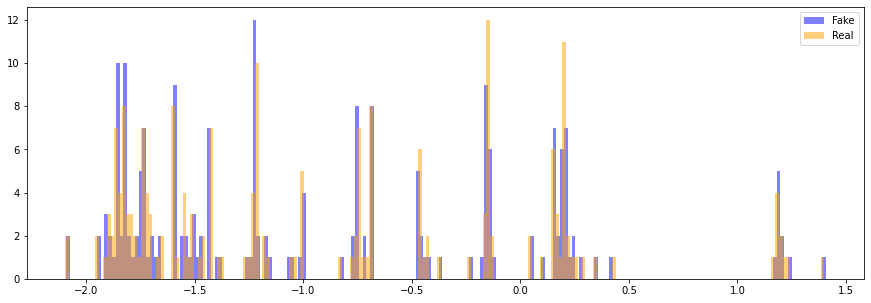

Executing op Minimum in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Maximum in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Sub in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AddV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Log in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mul in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Neg in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mean in device /job:localhost/replica:0/task:0/device:GPU:0


Executing op Cast in device /job:localhost/replica:0/task:0/device:GPU:0



train iou_score %: 21.56
Executing op StridedSlice in device /job:localhost/replica:0/task:0/device:GPU:0


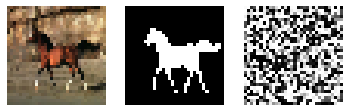

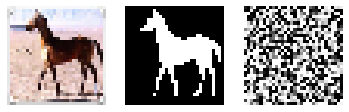

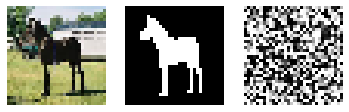

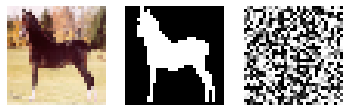

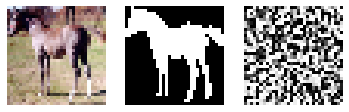

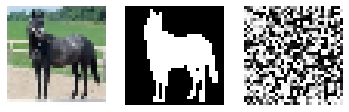

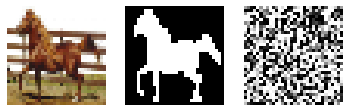

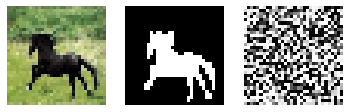

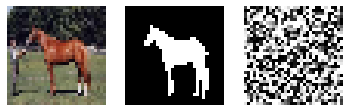

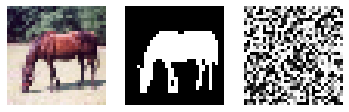


test iou_score %: 23.63


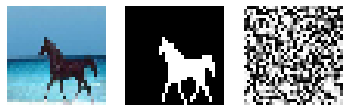

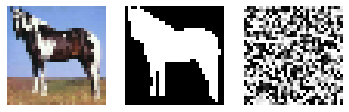

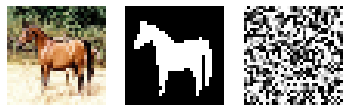

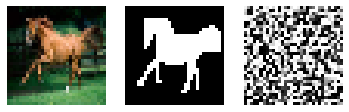

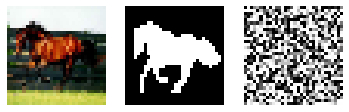

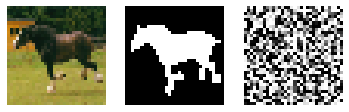

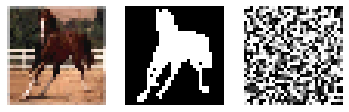

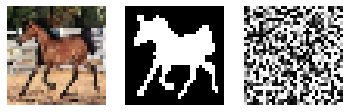

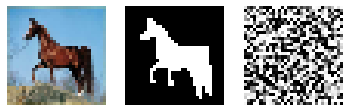

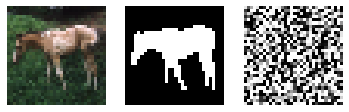


valid iou_score %: 22.64


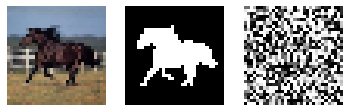

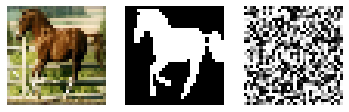

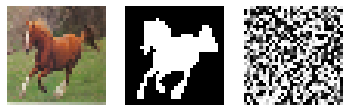

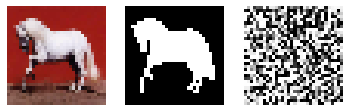

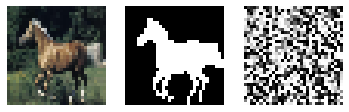

...

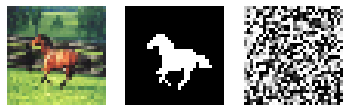

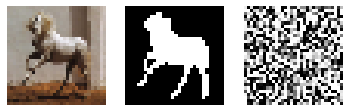

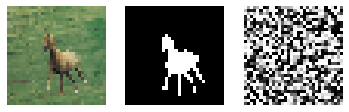

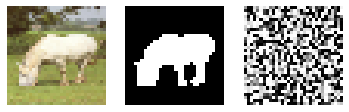

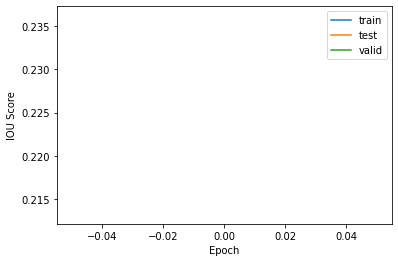

PT Gen Loss: 0.0, Gen Loss: 0.0, Dis Loss: -17.278385162353516, Adv Loss: -17.278385162353516

epoch: 1
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Minimum in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op BroadcastTo in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LessEqual in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AddN in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
PT Gen Loss: 1.6473090648651123, Gen Loss: 0.7609623670578003, Dis Loss: -19.43539810180664, Adv Loss: -19.43539810180664

epoch: 2
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localho

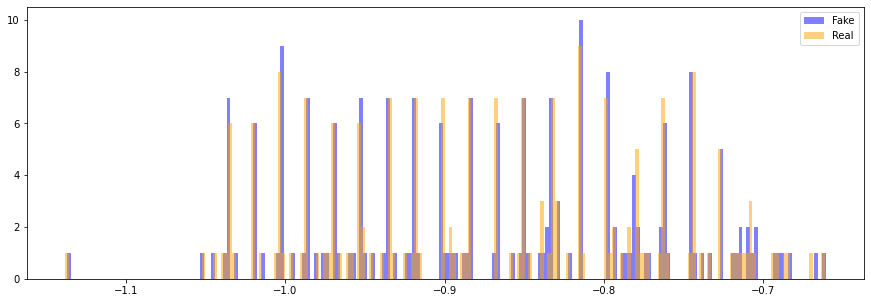


train iou_score %: 64.75


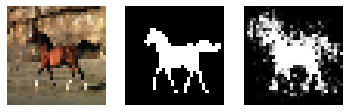

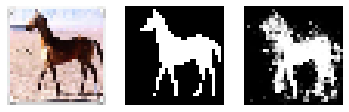

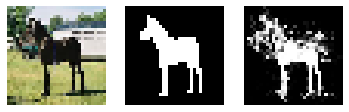

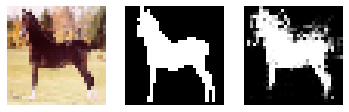

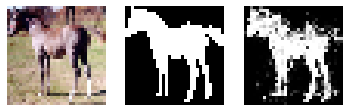

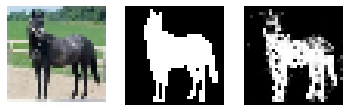

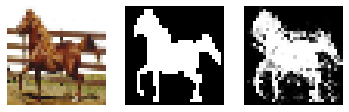

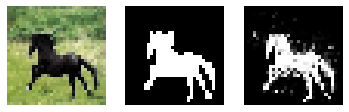

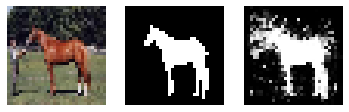

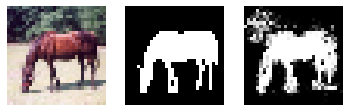


test iou_score %: 61.06


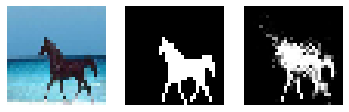

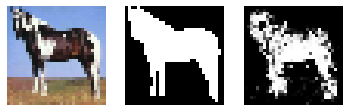

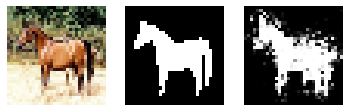

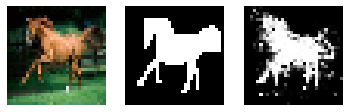

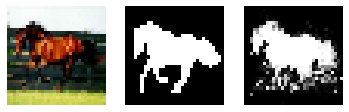

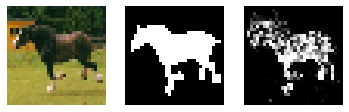

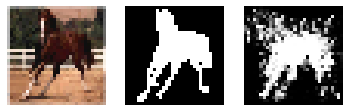

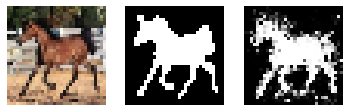

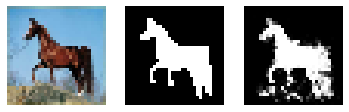

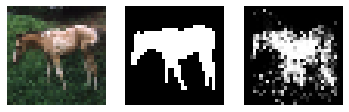


valid iou_score %: 57.07


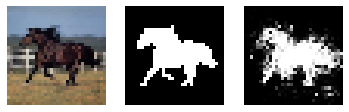

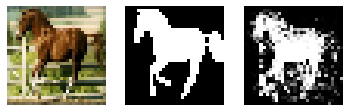

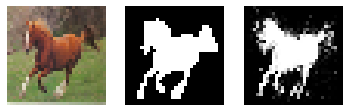

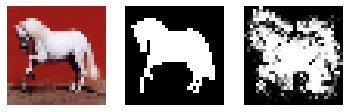

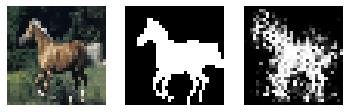

...

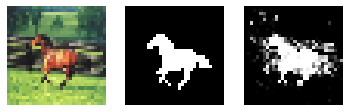

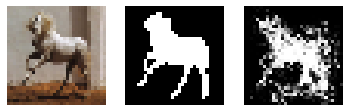

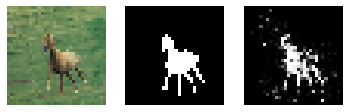

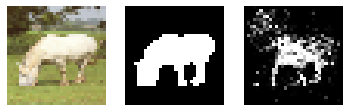

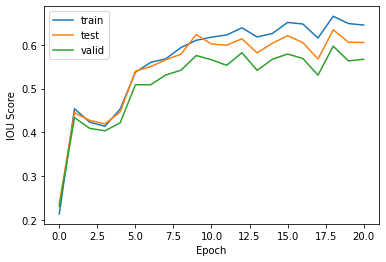

PT Gen Loss: 0.32930126786231995, Gen Loss: 0.8746111989021301, Dis Loss: -20.098060607910156, Adv Loss: -20.098060607910156

epoch: 21
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.31529611349105835, Gen Loss: 0.5137622952461243, Dis Loss: -20.31321907043457, Adv Loss: -20.31321907043457

epoch: 22
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.31498995423316956, Gen Loss: 0.14967307448387146, Dis Loss: -19.729055404663086, Adv Loss: -19.729055404663086

epoch: 23
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.2904502749443054, Gen Loss: 0.31769177317619324, Dis Loss: -20.449966430664062, Adv

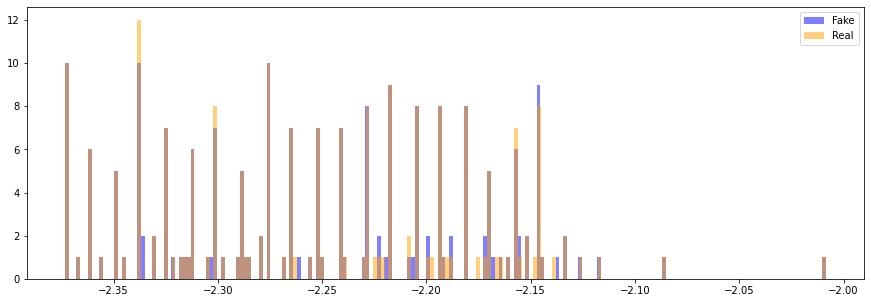


train iou_score %: 74.21


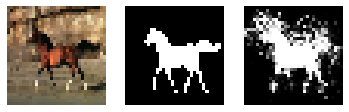

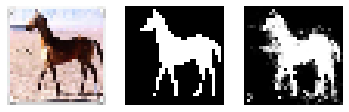

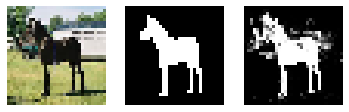

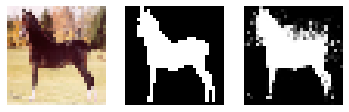

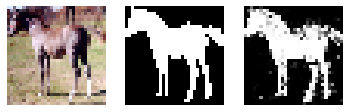

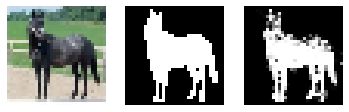

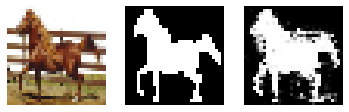

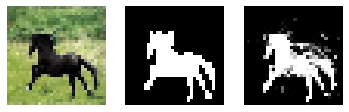

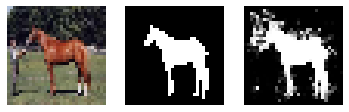

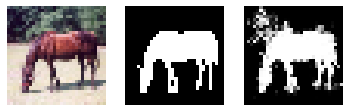


test iou_score %: 66.64


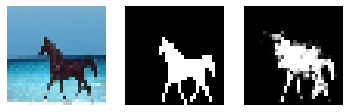

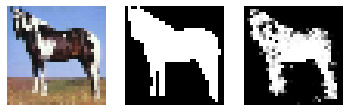

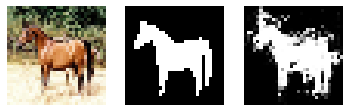

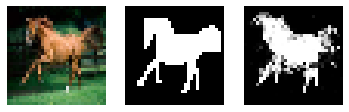

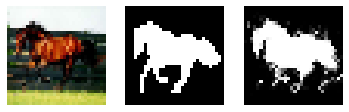

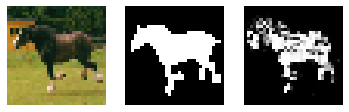

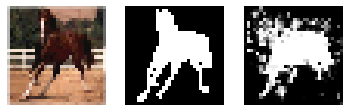

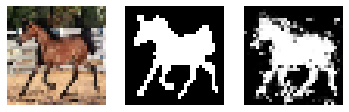

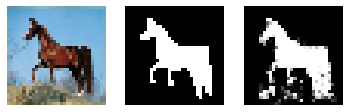

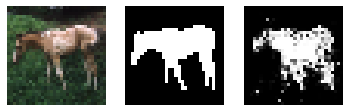


valid iou_score %: 62.59


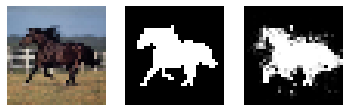

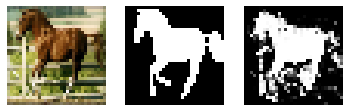

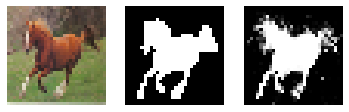

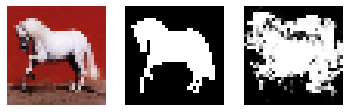

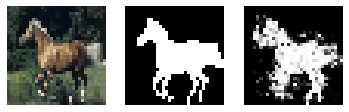

...

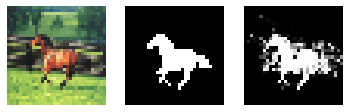

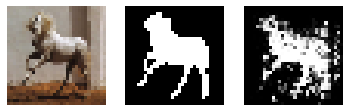

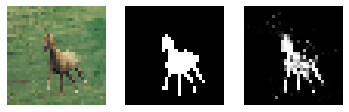

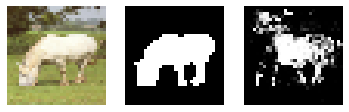

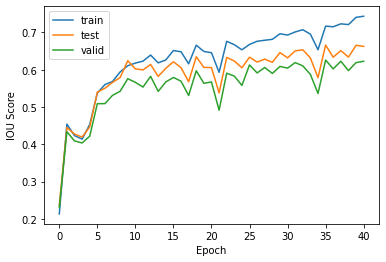

PT Gen Loss: 0.23051974177360535, Gen Loss: 2.2531802654266357, Dis Loss: -19.544574737548828, Adv Loss: -19.544574737548828

epoch: 41
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.22980034351348877, Gen Loss: 2.0162854194641113, Dis Loss: -19.62027931213379, Adv Loss: -19.62027931213379

epoch: 42
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.23032578825950623, Gen Loss: 1.7860069274902344, Dis Loss: -19.699764251708984, Adv Loss: -19.699764251708984

epoch: 43
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.21448898315429688, Gen Loss: 1.561974048614502, Dis Loss: -19.78365707397461, Adv Lo

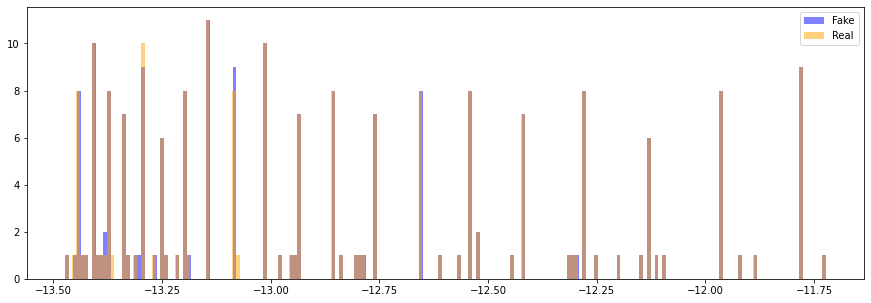


train iou_score %: 81.88


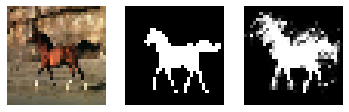

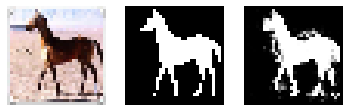

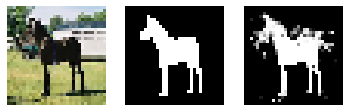

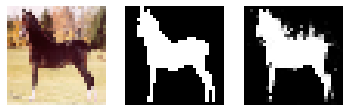

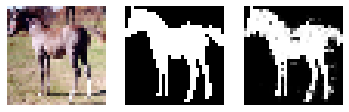

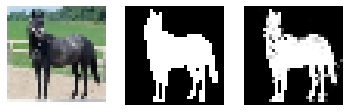

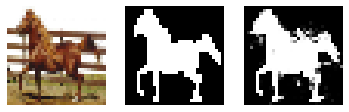

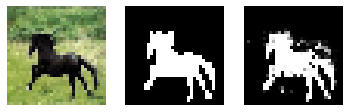

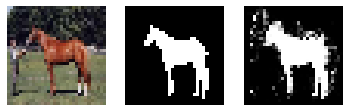

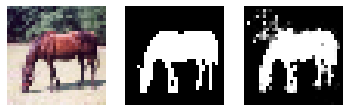


test iou_score %: 68.35


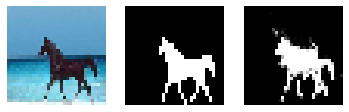

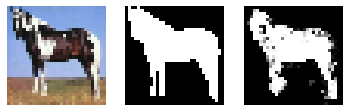

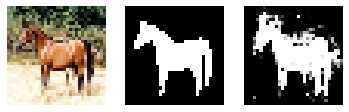

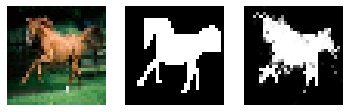

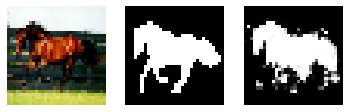

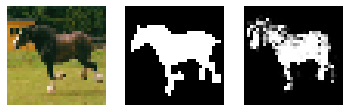

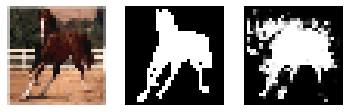

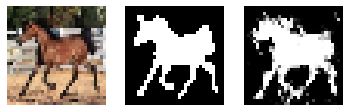

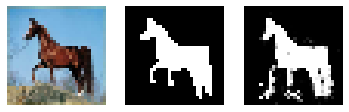

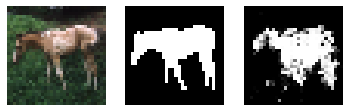


valid iou_score %: 64.25


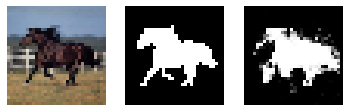

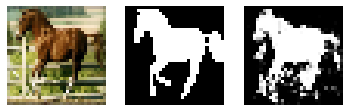

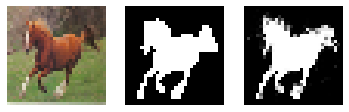

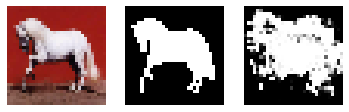

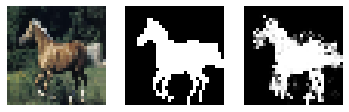

...

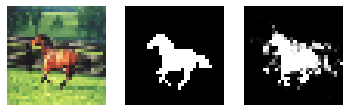

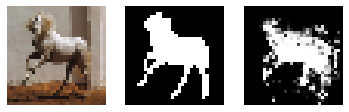

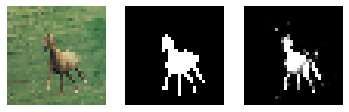

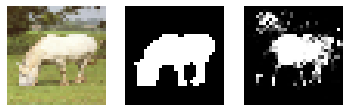

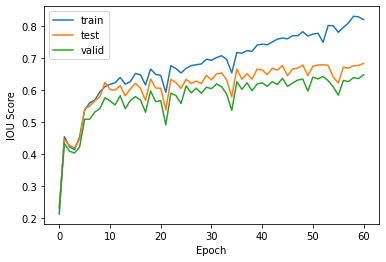

PT Gen Loss: 0.16078400611877441, Gen Loss: 12.848864555358887, Dis Loss: -18.095848083496094, Adv Loss: -18.095848083496094

epoch: 61
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.19131460785865784, Gen Loss: 13.608390808105469, Dis Loss: -18.04180908203125, Adv Loss: -18.04180908203125

epoch: 62
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.16682341694831848, Gen Loss: 13.693036079406738, Dis Loss: -18.036014556884766, Adv Loss: -18.036014556884766

epoch: 63
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.20430631935596466, Gen Loss: 13.691499710083008, Dis Loss: -18.036144256591797, Adv 

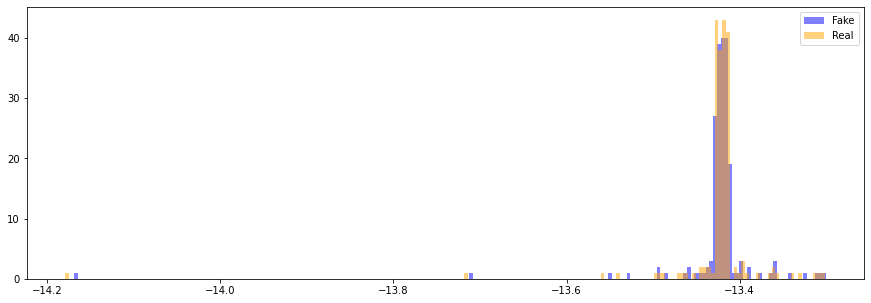


train iou_score %: 82.35


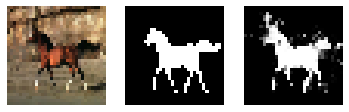

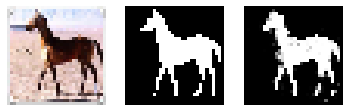

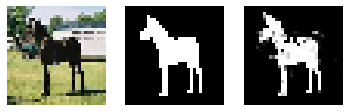

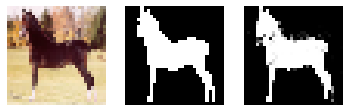

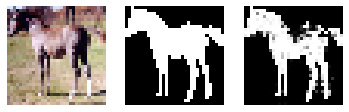

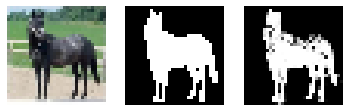

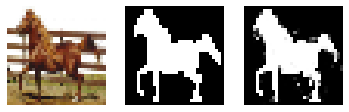

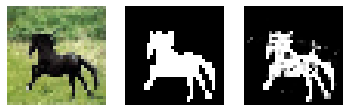

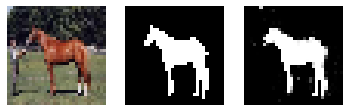

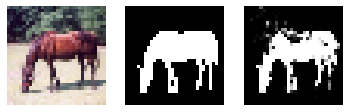


test iou_score %: 61.54


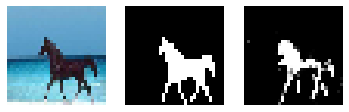

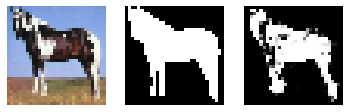

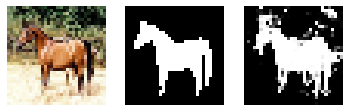

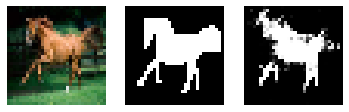

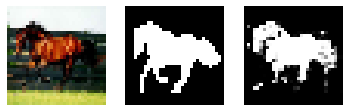

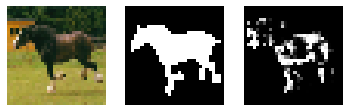

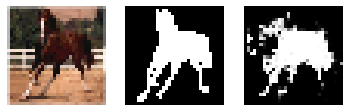

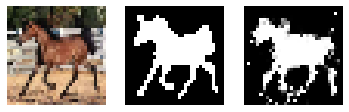

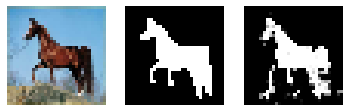

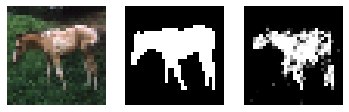


valid iou_score %: 58.76


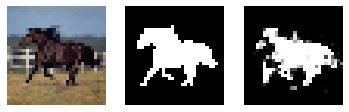

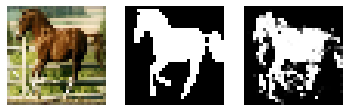

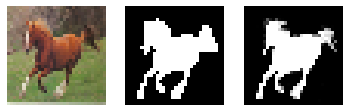

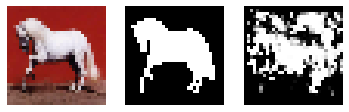

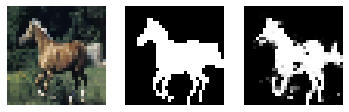

...

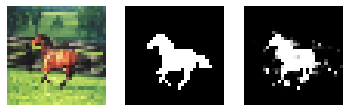

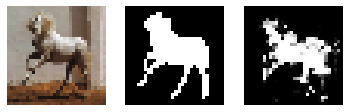

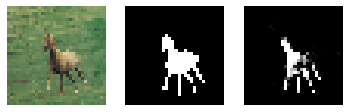

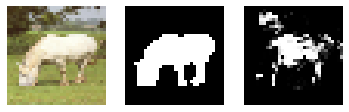

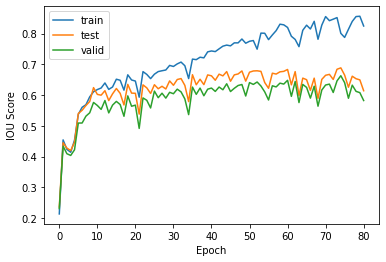

PT Gen Loss: 0.1242075189948082, Gen Loss: 13.425312995910645, Dis Loss: -18.054378509521484, Adv Loss: -18.054378509521484

epoch: 81
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.14385220408439636, Gen Loss: 13.408197402954102, Dis Loss: -18.05558204650879, Adv Loss: -18.05558204650879

epoch: 82
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.15834075212478638, Gen Loss: 13.39076042175293, Dis Loss: -18.056791305541992, Adv Loss: -18.056791305541992

epoch: 83
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.12874890863895416, Gen Loss: 13.372787475585938, Dis Loss: -18.058027267456055, Adv Lo

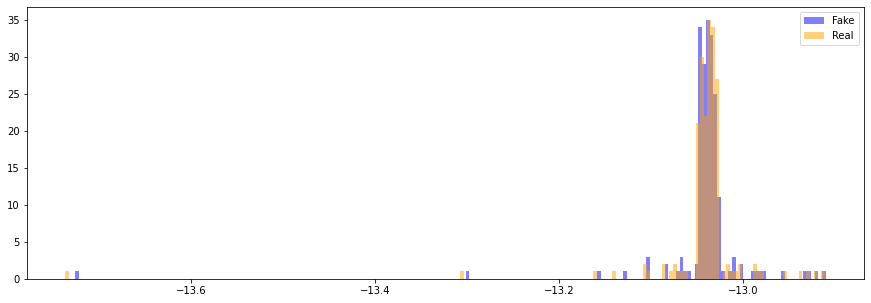


train iou_score %: 88.86


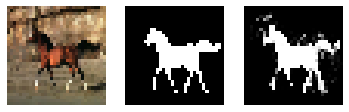

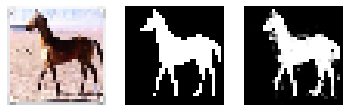

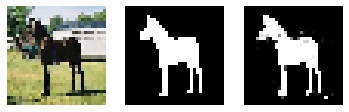

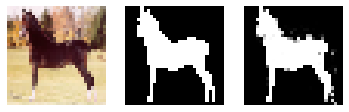

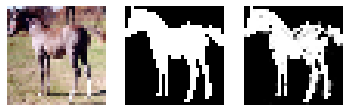

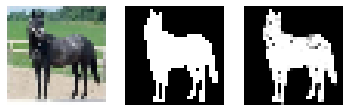

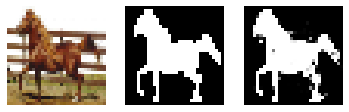

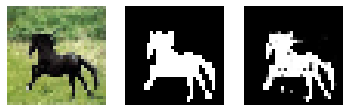

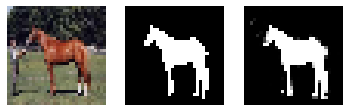

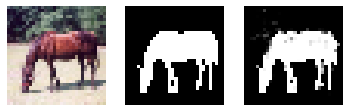


test iou_score %: 63.72


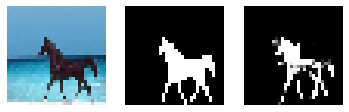

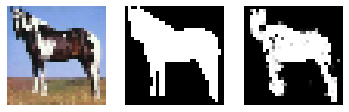

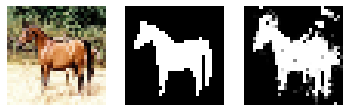

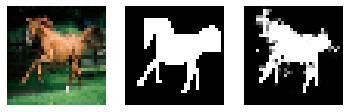

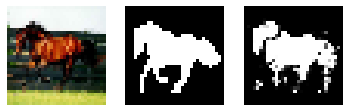

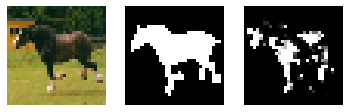

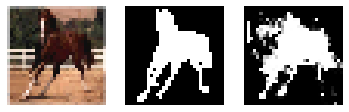

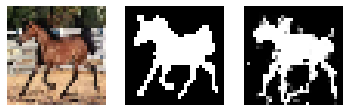

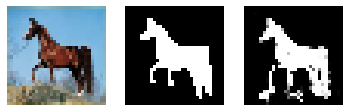

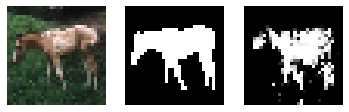


valid iou_score %: 59.53


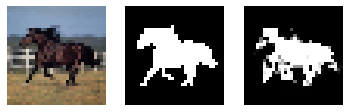

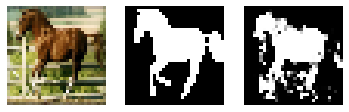

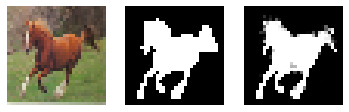

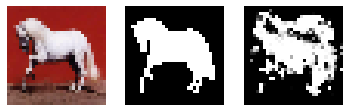

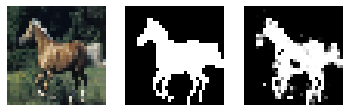

...

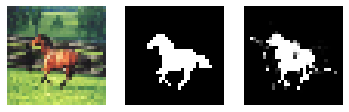

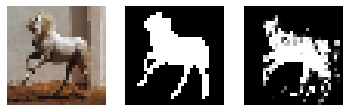

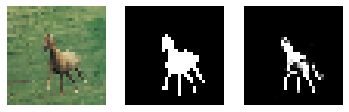

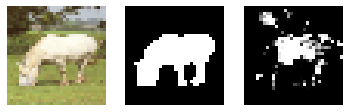

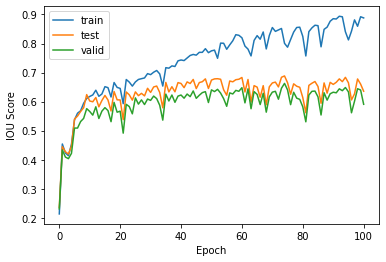

PT Gen Loss: 0.0924426019191742, Gen Loss: 13.042370796203613, Dis Loss: -18.08125114440918, Adv Loss: -18.08125114440918

epoch: 101
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.09573783725500107, Gen Loss: 13.021245956420898, Dis Loss: -18.082765579223633, Adv Loss: -18.082765579223633

epoch: 102
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.10088697820901871, Gen Loss: 12.999963760375977, Dis Loss: -18.084287643432617, Adv Loss: -18.084287643432617

epoch: 103
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.11520469188690186, Gen Loss: 12.978574752807617, Dis Loss: -18.085832595825195, Ad

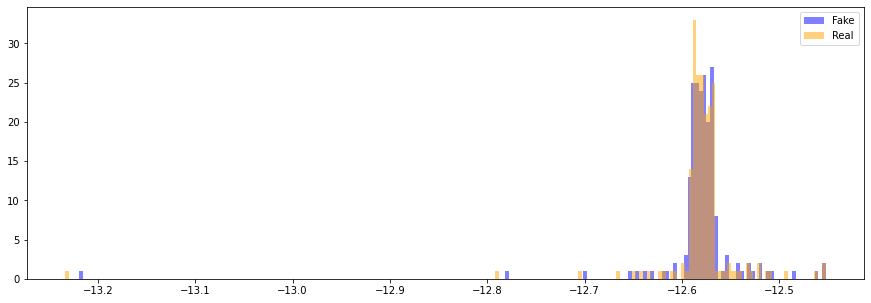


train iou_score %: 91.87


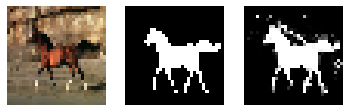

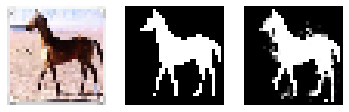

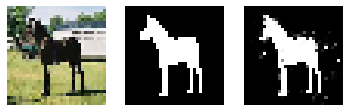

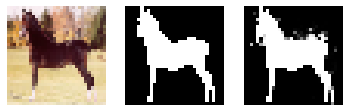

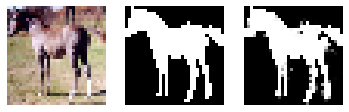

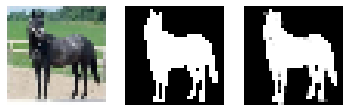

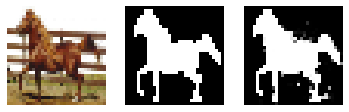

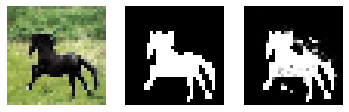

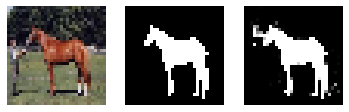

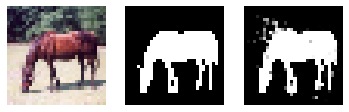


test iou_score %: 66.85


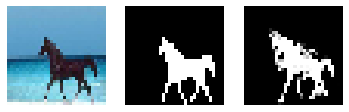

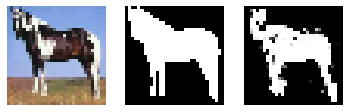

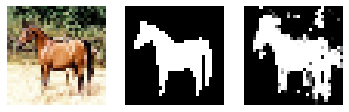

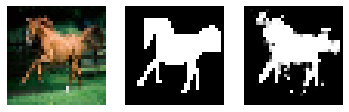

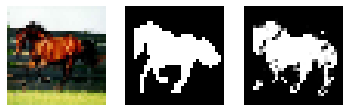

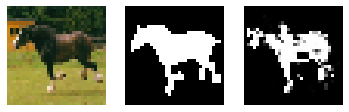

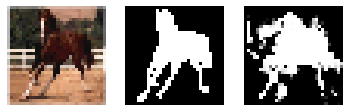

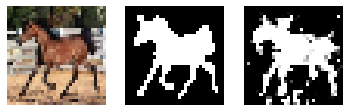

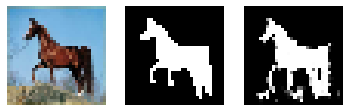

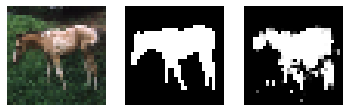


valid iou_score %: 63.19


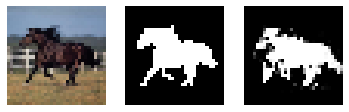

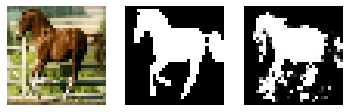

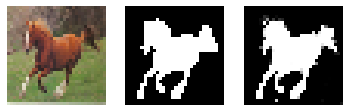

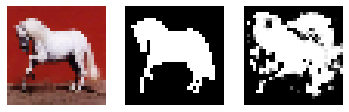

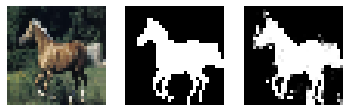

...

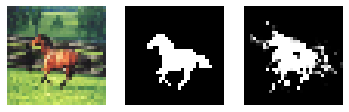

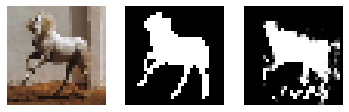

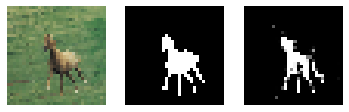

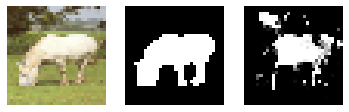

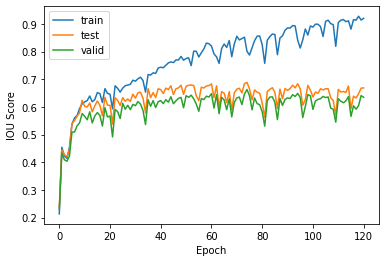

PT Gen Loss: 0.07090187072753906, Gen Loss: 12.581286430358887, Dis Loss: -18.114635467529297, Adv Loss: -18.114635467529297

epoch: 121
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.06303618848323822, Gen Loss: 12.55596923828125, Dis Loss: -18.11648941040039, Adv Loss: -18.11648941040039

epoch: 122
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.06752004474401474, Gen Loss: 12.530649185180664, Dis Loss: -18.118366241455078, Adv Loss: -18.118366241455078

epoch: 123
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.0711168572306633, Gen Loss: 12.505087852478027, Dis Loss: -18.120256423950195, Adv

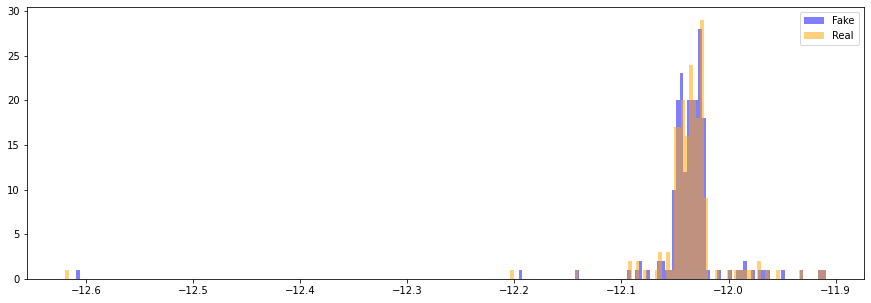


train iou_score %: 94.44


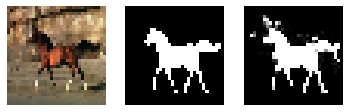

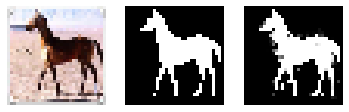

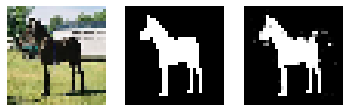

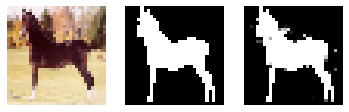

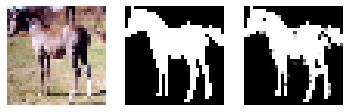

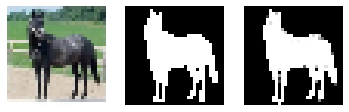

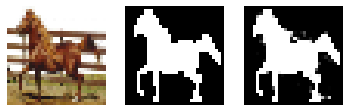

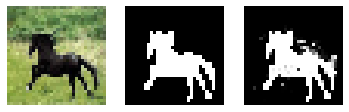

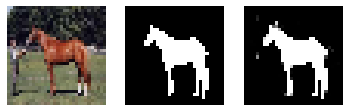

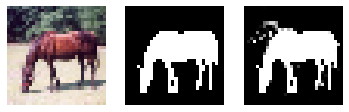


test iou_score %: 67.42


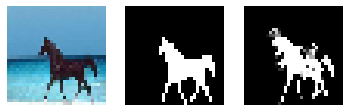

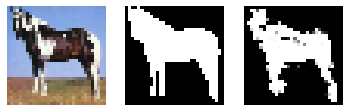

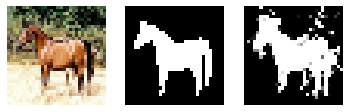

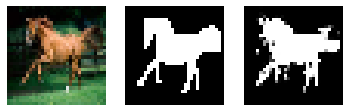

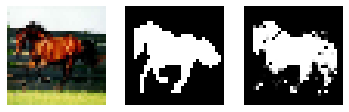

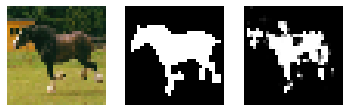

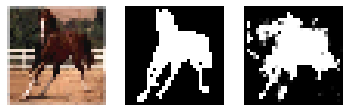

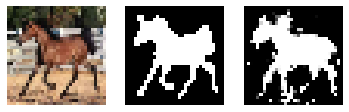

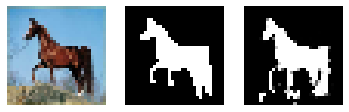

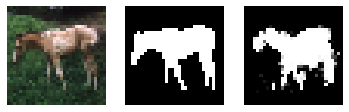


valid iou_score %: 64.16


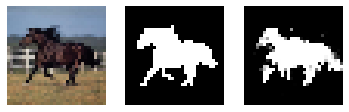

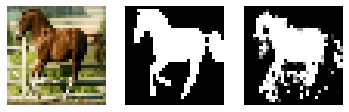

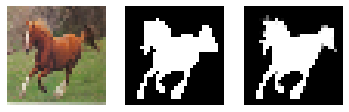

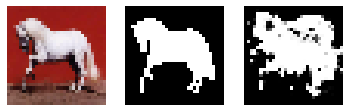

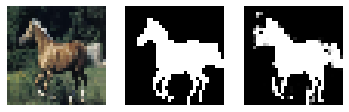

...

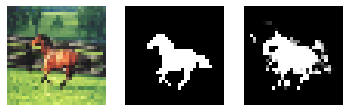

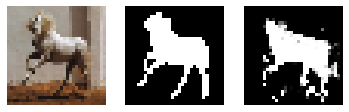

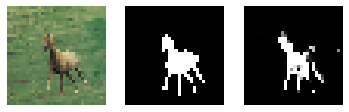

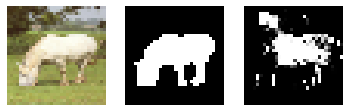

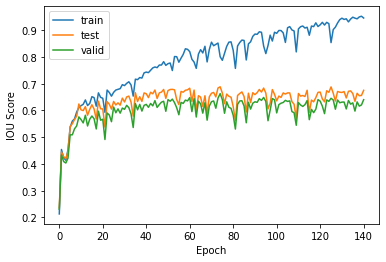

PT Gen Loss: 0.048481158912181854, Gen Loss: 12.037312507629395, Dis Loss: -18.155492782592773, Adv Loss: -18.155492782592773

epoch: 141
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.04946112260222435, Gen Loss: 12.0079345703125, Dis Loss: -18.15774917602539, Adv Loss: -18.15774917602539

epoch: 142
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.05787801742553711, Gen Loss: 11.978395462036133, Dis Loss: -18.1600284576416, Adv Loss: -18.1600284576416

epoch: 143
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.0511523112654686, Gen Loss: 11.948450088500977, Dis Loss: -18.162334442138672, Adv Los

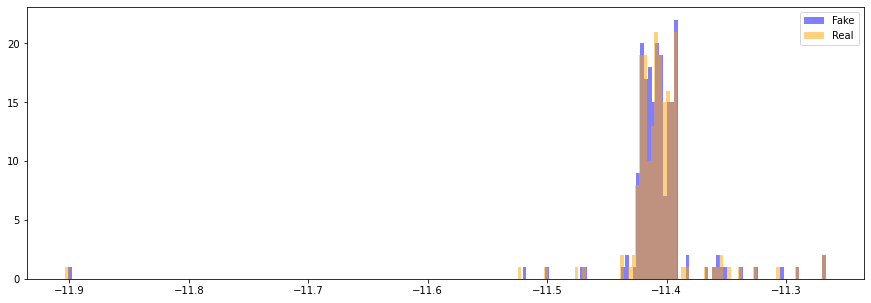


train iou_score %: 96.73


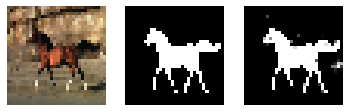

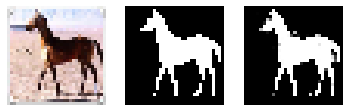

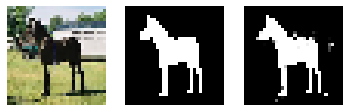

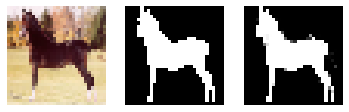

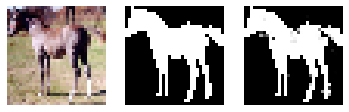

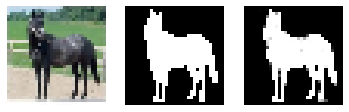

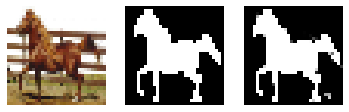

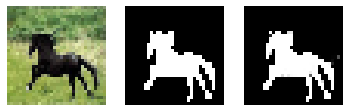

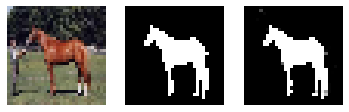

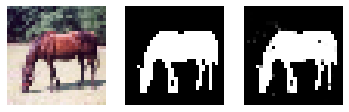


test iou_score %: 65.11


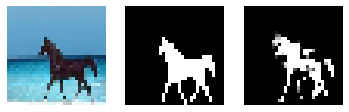

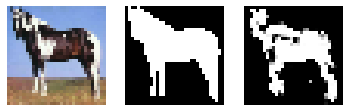

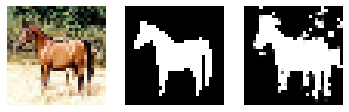

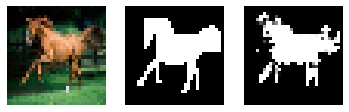

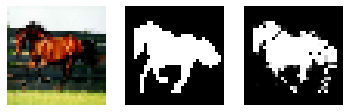

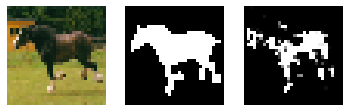

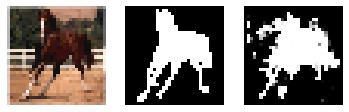

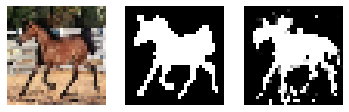

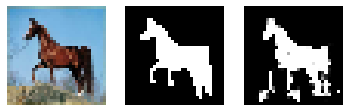

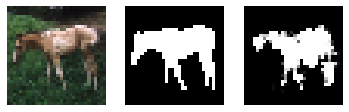


valid iou_score %: 60.89


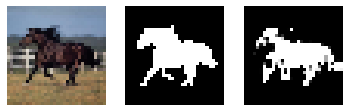

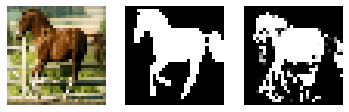

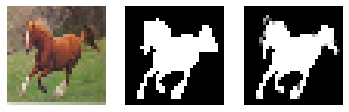

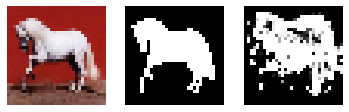

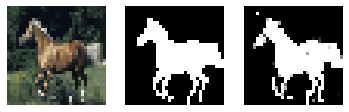

...

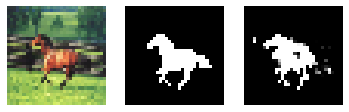

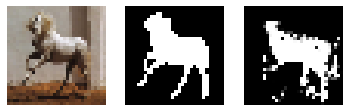

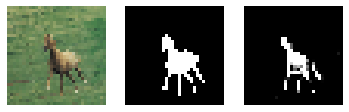

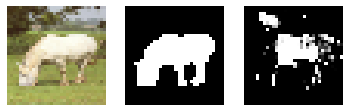

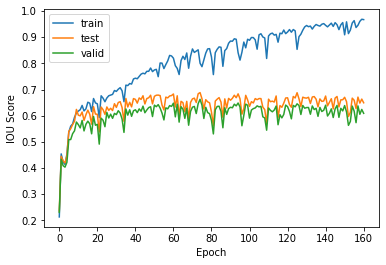

PT Gen Loss: 0.030479347333312035, Gen Loss: 11.407319068908691, Dis Loss: -18.20501136779785, Adv Loss: -18.20501136779785

epoch: 161
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.0389024056494236, Gen Loss: 11.373594284057617, Dis Loss: -18.207735061645508, Adv Loss: -18.207735061645508

epoch: 162
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.07490353286266327, Gen Loss: 11.339970588684082, Dis Loss: -18.210485458374023, Adv Loss: -18.210485458374023

epoch: 163
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.05849238112568855, Gen Loss: 11.305618286132812, Dis Loss: -18.213260650634766, A

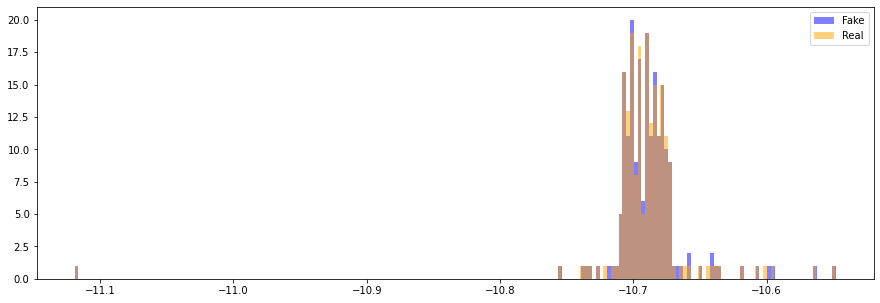


train iou_score %: 98.0


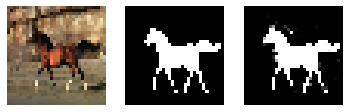

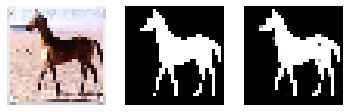

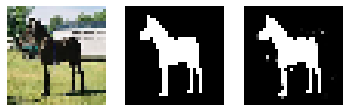

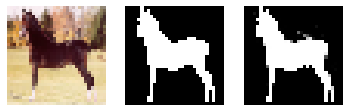

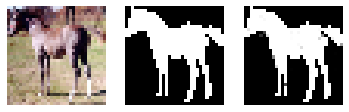

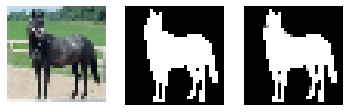

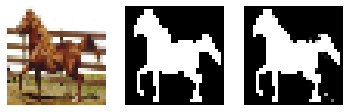

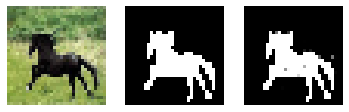

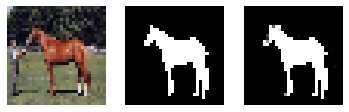

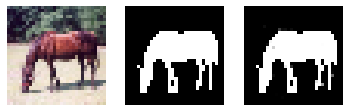


test iou_score %: 66.5


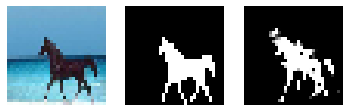

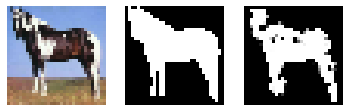

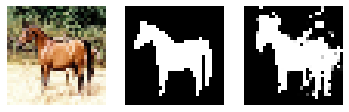

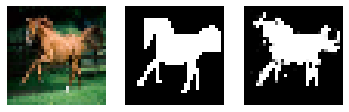

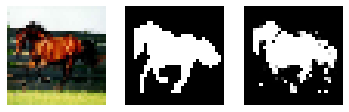

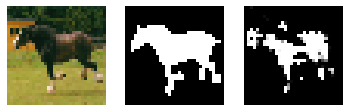

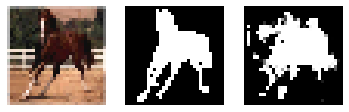

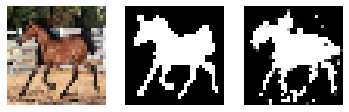

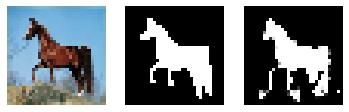

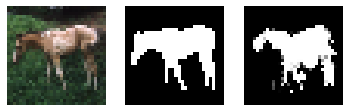


valid iou_score %: 62.69


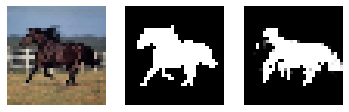

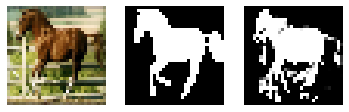

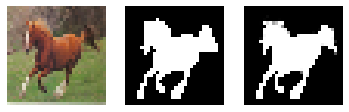

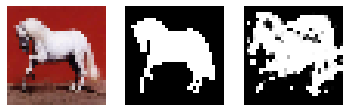

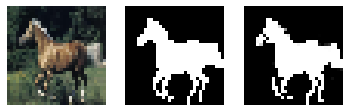

...

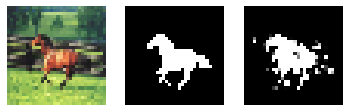

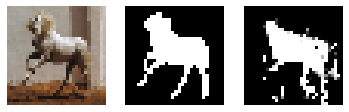

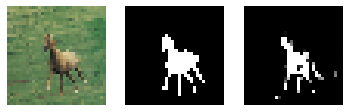

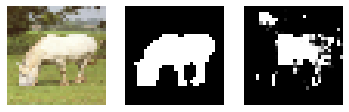

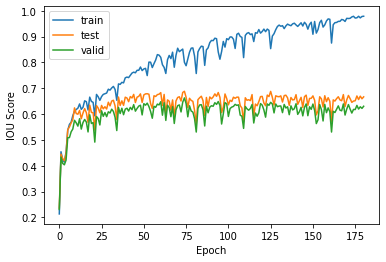

PT Gen Loss: 0.01915590837597847, Gen Loss: 10.689836502075195, Dis Loss: -18.26456642150879, Adv Loss: -18.26456642150879

epoch: 181
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.02373966947197914, Gen Loss: 10.651769638061523, Dis Loss: -18.267833709716797, Adv Loss: -18.267833709716797

epoch: 182
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.023383650928735733, Gen Loss: 10.613386154174805, Dis Loss: -18.271129608154297, Adv Loss: -18.271129608154297

epoch: 183
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.024632276967167854, Gen Loss: 10.574819564819336, Dis Loss: -18.274459838867188,

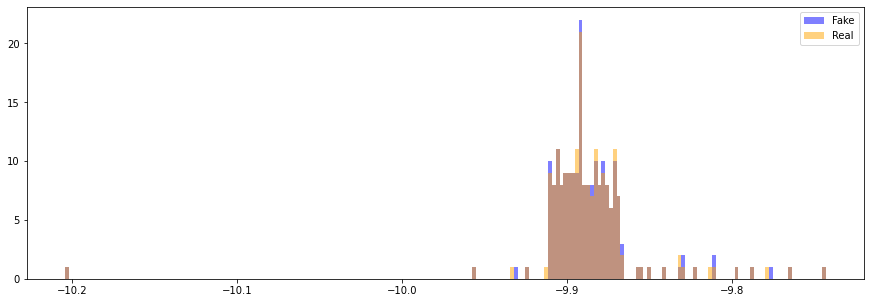


train iou_score %: 97.94


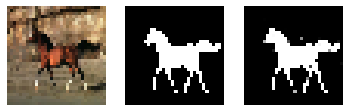

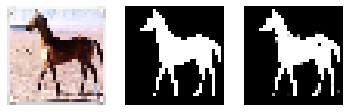

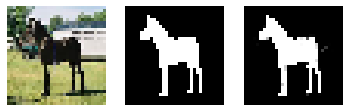

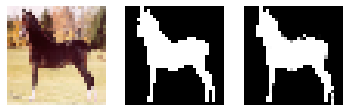

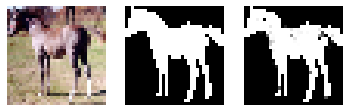

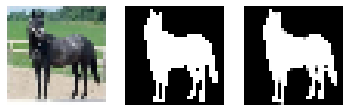

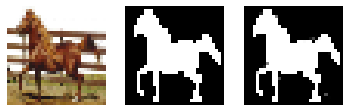

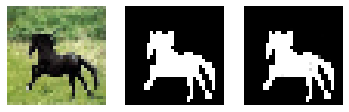

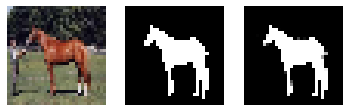

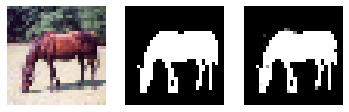


test iou_score %: 65.4


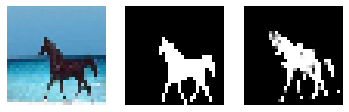

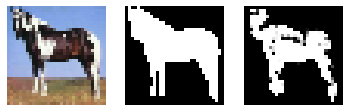

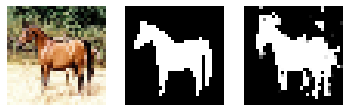

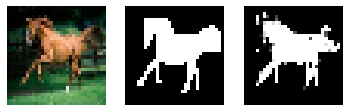

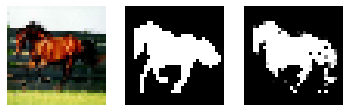

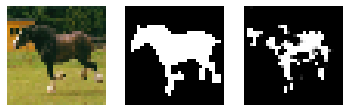

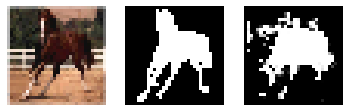

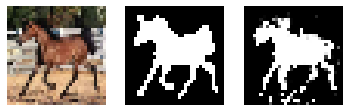

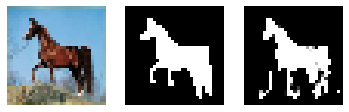

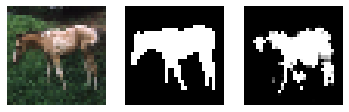


valid iou_score %: 60.86


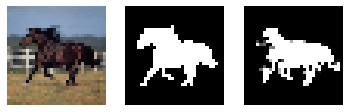

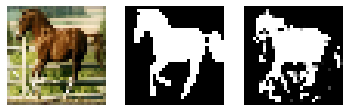

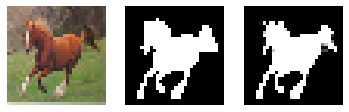

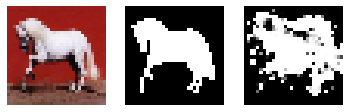

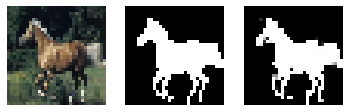

...

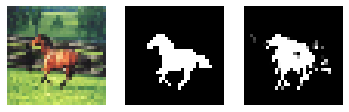

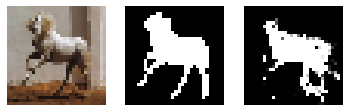

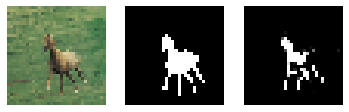

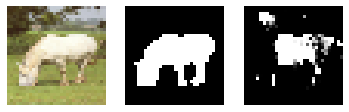

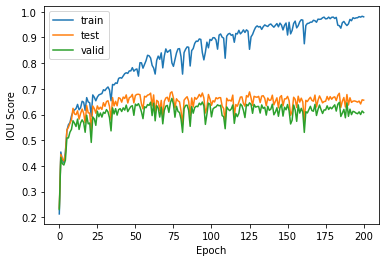

PT Gen Loss: 0.019182367250323296, Gen Loss: 9.886734008789062, Dis Loss: -18.335739135742188, Adv Loss: -18.335739135742188

epoch: 201
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.02123720571398735, Gen Loss: 9.8444242477417, Dis Loss: -18.339635848999023, Adv Loss: -18.339635848999023

epoch: 202
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.02283451333642006, Gen Loss: 9.801939964294434, Dis Loss: -18.343563079833984, Adv Loss: -18.343563079833984

epoch: 203
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.014898063614964485, Gen Loss: 9.759134292602539, Dis Loss: -18.3475284576416, Adv L

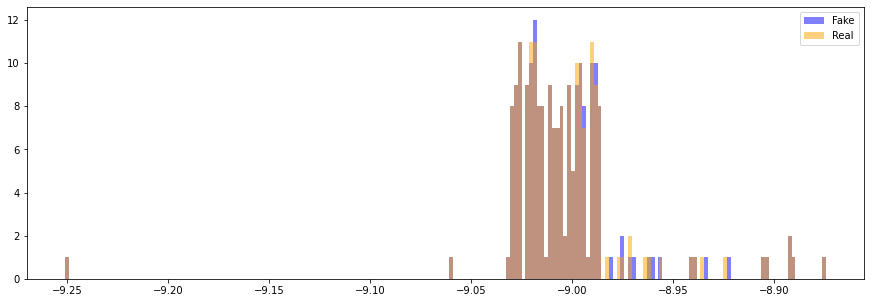


train iou_score %: 98.01


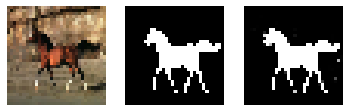

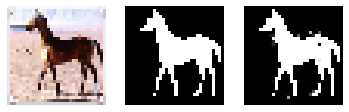

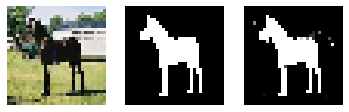

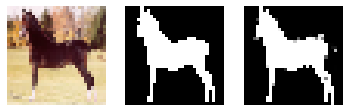

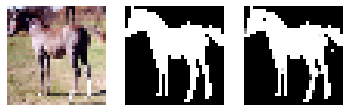

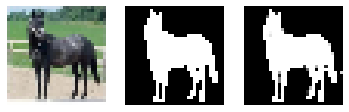

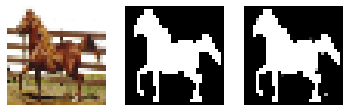

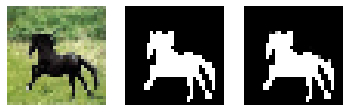

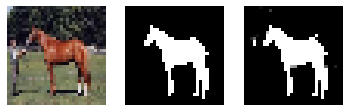

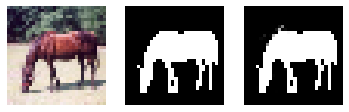


test iou_score %: 67.12


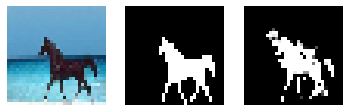

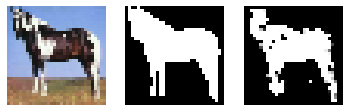

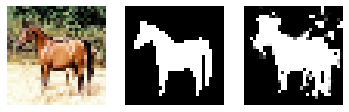

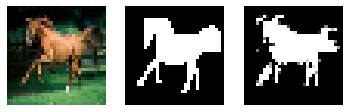

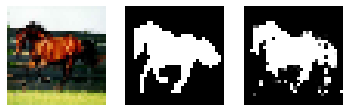

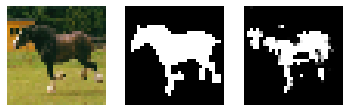

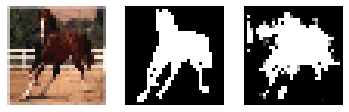

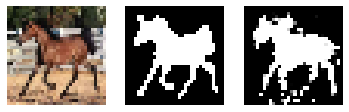

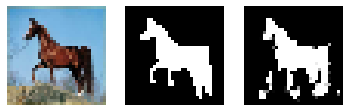

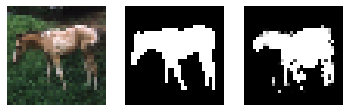


valid iou_score %: 63.79


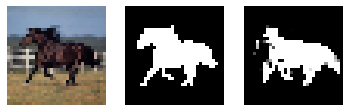

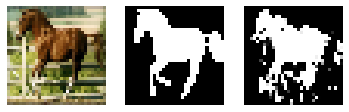

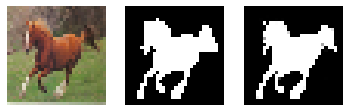

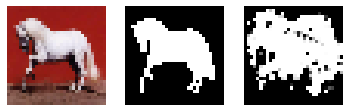

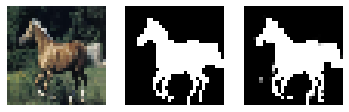

...

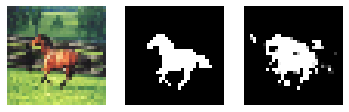

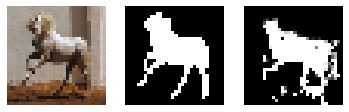

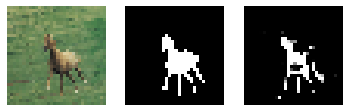

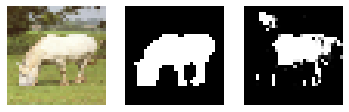

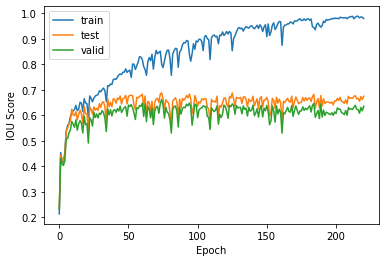

PT Gen Loss: 0.015299837104976177, Gen Loss: 9.003580093383789, Dis Loss: -18.420339584350586, Adv Loss: -18.420339584350586

epoch: 221
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.0173611082136631, Gen Loss: 8.957488059997559, Dis Loss: -18.424962997436523, Adv Loss: -18.424962997436523

epoch: 222
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.015159030444920063, Gen Loss: 8.911202430725098, Dis Loss: -18.42962074279785, Adv Loss: -18.42962074279785

epoch: 223
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.015845317393541336, Gen Loss: 8.864744186401367, Dis Loss: -18.434316635131836, Adv

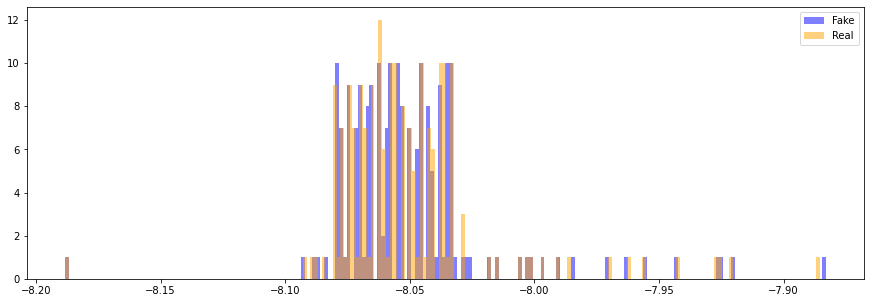


train iou_score %: 92.16


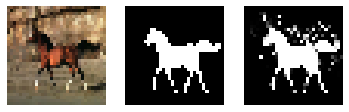

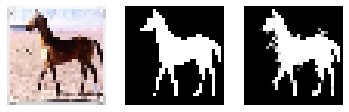

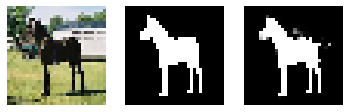

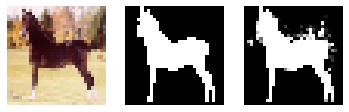

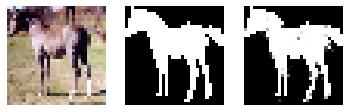

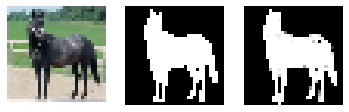

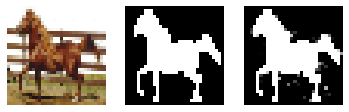

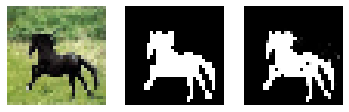

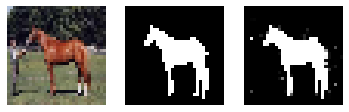

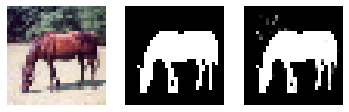


test iou_score %: 67.23


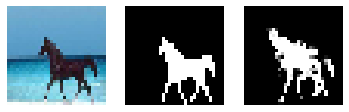

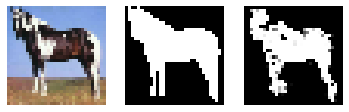

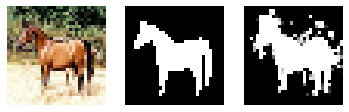

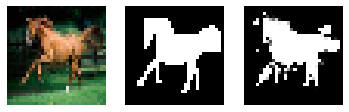

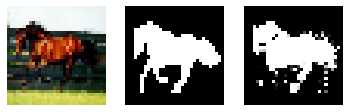

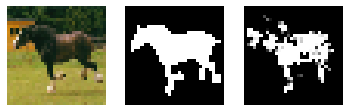

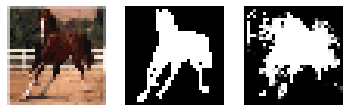

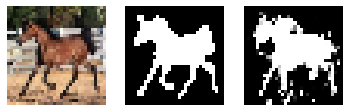

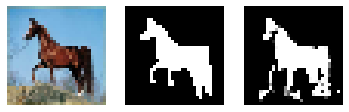

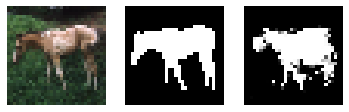


valid iou_score %: 63.97


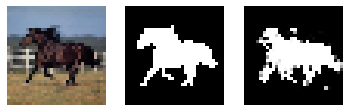

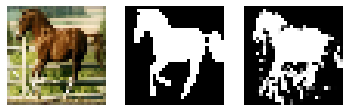

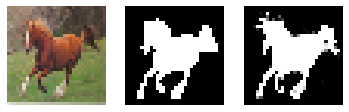

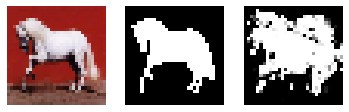

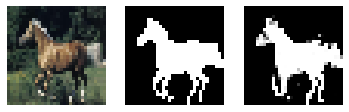

...

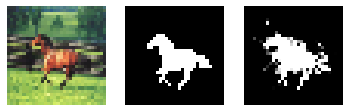

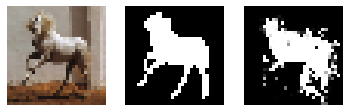

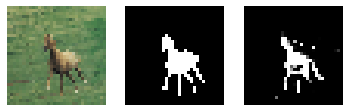

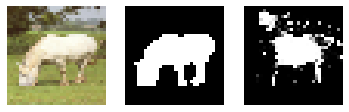

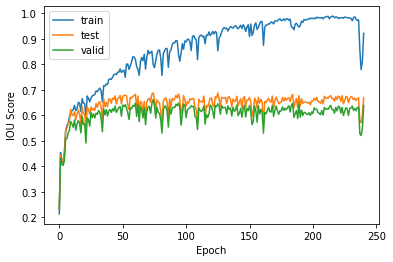

PT Gen Loss: 0.1479964554309845, Gen Loss: 8.051589965820312, Dis Loss: -18.52049446105957, Adv Loss: -18.52049446105957

epoch: 241
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.07326887547969818, Gen Loss: 8.001588821411133, Dis Loss: -18.525951385498047, Adv Loss: -18.525951385498047

epoch: 242
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.041330721229314804, Gen Loss: 7.951830863952637, Dis Loss: -18.531455993652344, Adv Loss: -18.531455993652344

epoch: 243
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.02578502893447876, Gen Loss: 7.902127265930176, Dis Loss: -18.537006378173828, Adv L

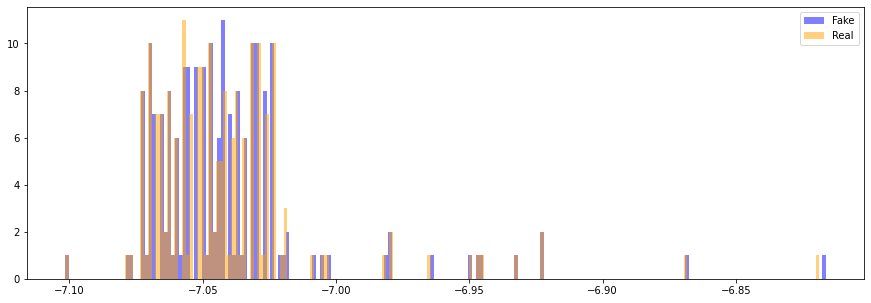


train iou_score %: 99.15


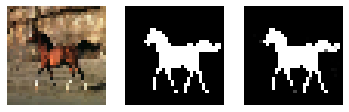

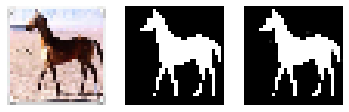

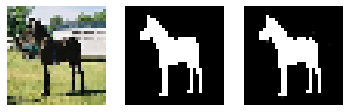

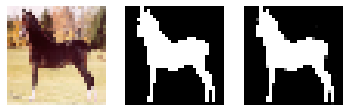

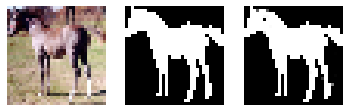

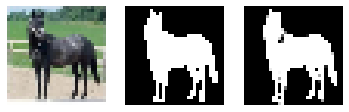

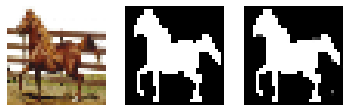

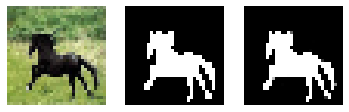

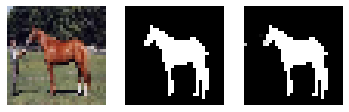

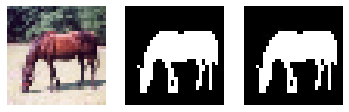


test iou_score %: 66.69


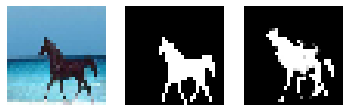

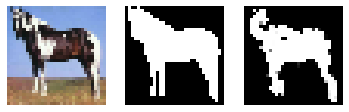

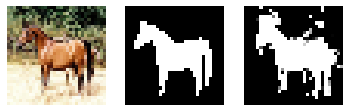

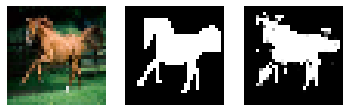

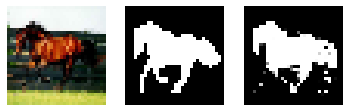

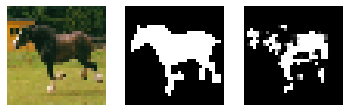

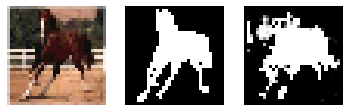

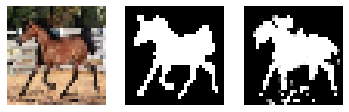

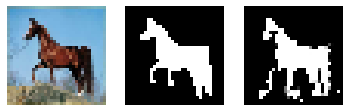

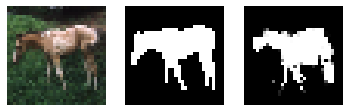


valid iou_score %: 61.98


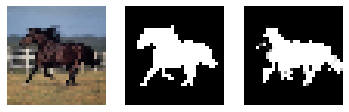

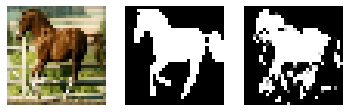

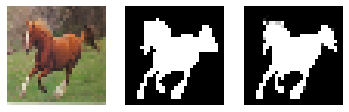

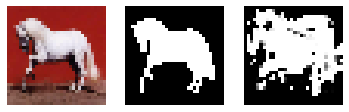

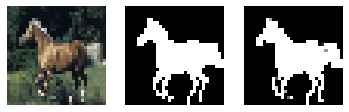

...

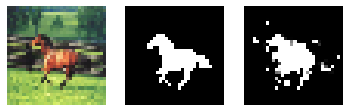

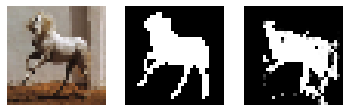

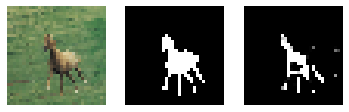

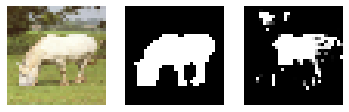

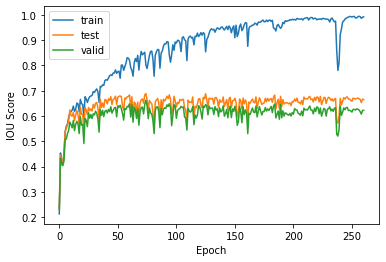

PT Gen Loss: 0.009679438546299934, Gen Loss: 7.040666103363037, Dis Loss: -18.63877296447754, Adv Loss: -18.63877296447754

epoch: 261
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.007381991483271122, Gen Loss: 6.988986968994141, Dis Loss: -18.64521598815918, Adv Loss: -18.64521598815918

epoch: 262
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.00696332473307848, Gen Loss: 6.9372382164001465, Dis Loss: -18.651710510253906, Adv Loss: -18.651710510253906

epoch: 263
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.007256837096065283, Gen Loss: 6.8853960037231445, Dis Loss: -18.658267974853516, Ad

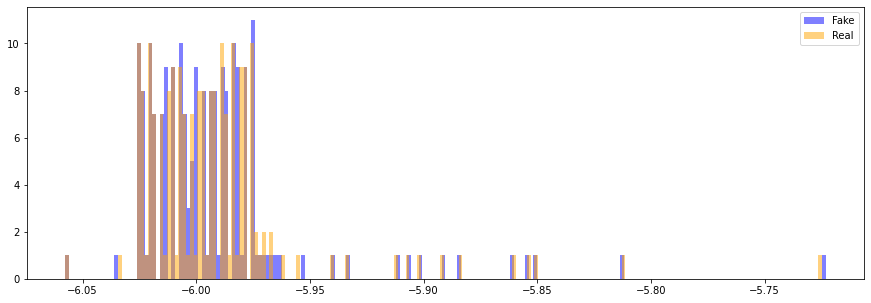


train iou_score %: 98.91


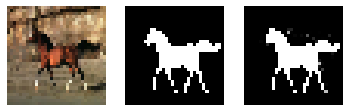

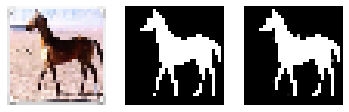

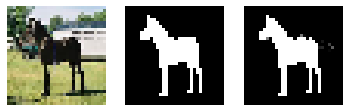

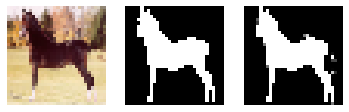

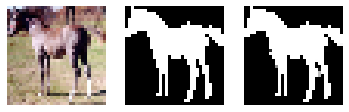

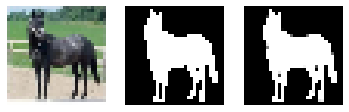

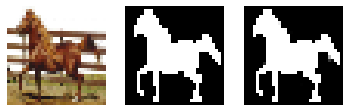

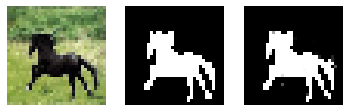

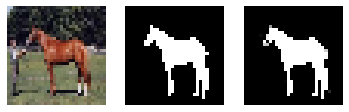

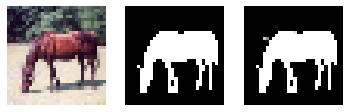


test iou_score %: 67.07


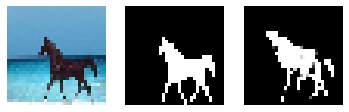

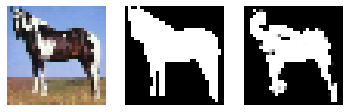

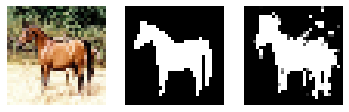

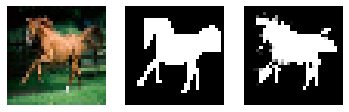

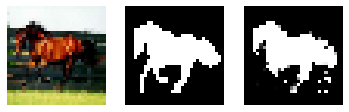

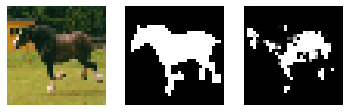

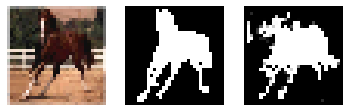

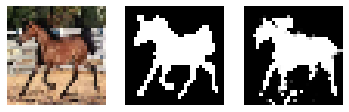

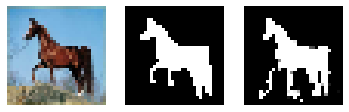

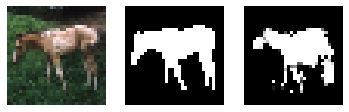


valid iou_score %: 62.97


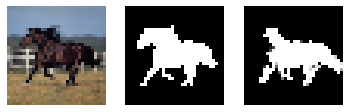

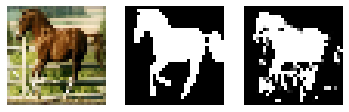

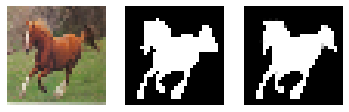

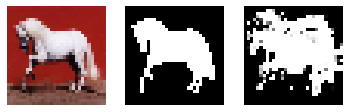

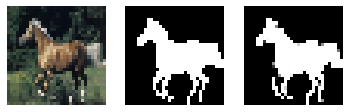

...

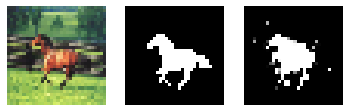

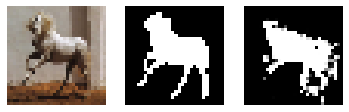

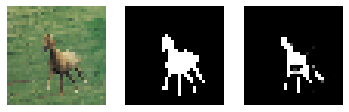

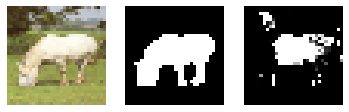

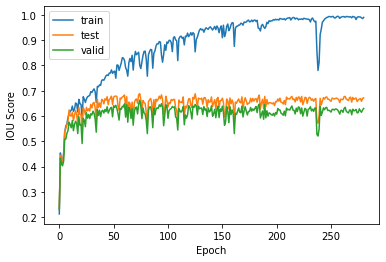

PT Gen Loss: 0.014238061383366585, Gen Loss: 5.991817474365234, Dis Loss: -18.778553009033203, Adv Loss: -18.778553009033203

epoch: 281
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.009321046993136406, Gen Loss: 5.9386091232299805, Dis Loss: -18.78618621826172, Adv Loss: -18.78618621826172

epoch: 282
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.008767019025981426, Gen Loss: 5.88538122177124, Dis Loss: -18.79388427734375, Adv Loss: -18.79388427734375

epoch: 283
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.013738545589148998, Gen Loss: 5.832188606262207, Dis Loss: -18.80164909362793, Adv 

In [12]:
# general
batch_size = 10
n_epoch = 300
n_figs = 10

# disc
n_update_dis = 1
d_learning_rate = 0.0003

# pretrain gen
alpha = 0.01
pt_gen = True
pt_g_learning_rate = 0.001

# ebm gen
inf_iter = 5 #alpha
inf_rate = 2 #delta
g_learning_rate = 0.0003

##############################################################################################################

# create tf dataset generator object
N = len(xdata)
train_dataset = tf.data.Dataset.from_tensor_slices((xdata, ydata))
train_dataset = train_dataset.shuffle(buffer_size=N)
train_dataset = train_dataset.batch(batch_size=batch_size, drop_remainder=False)

# Initialize Networks
gen = Generator()
dis = Discriminator()

# Initialize Optimizer
gen_opt = tf.keras.optimizers.Adam(g_learning_rate)
gen_opt_pt = tf.keras.optimizers.Adam(pt_g_learning_rate)
dis_opt = tf.keras.optimizers.Adam(d_learning_rate)

# Initialize Metrics
adv_loss = tf.keras.metrics.Mean(name = 'Adversarial_Loss')
dis_loss = tf.keras.metrics.Mean(name = 'Discriminator_Loss')
gen_loss = tf.keras.metrics.Mean(name = 'Generator_Loss')
gen_pretrain_loss = tf.keras.metrics.Mean(name = 'Generator_Pretrain_Loss')

train(train_dataset, n_epoch, n_update_dis, inf_iter, inf_rate, pt_gen, alpha)